# Flatmaps of final parcellation

In [4]:
import sys
sys.path.append("..")
import ProbabilisticParcellation.evaluate as ev
import ProbabilisticParcellation.util as ut
import ProbabilisticParcellation.export_atlas as ea
import ProbabilisticParcellation.scripts.atlas_paper.parcel_hierarchy as ph
import ProbabilisticParcellation.scripts.atlas_paper.evaluate_atlas as eva
from Functional_Fusion.dataset import *
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sb
import pandas as pd
import torch as pt


# Plotting renamed Models to ensure they are correct

# Symmetric 68 map

In [5]:
figure_path = "/Users/jdiedrichsen/Dropbox (Diedrichsenlab)/papers/AtlasPaper/figure_parts/"
if not os.path.exists(figure_path):
    figure_path = "/Users/callithrix/Dropbox/AtlasPaper/figure_parts/"
atlas_dir = '/Volumes/diedrichsen_data$/data/Cerebellum/ProbabilisticParcellationModel/Atlases/'

In [7]:
info_Sym68, model_Sym68 = ut.load_batch_best(
    'Models_03/NettekovenSym68_space-MNISymC2')
info_Asym68, model_Asym68 = ut.load_batch_best(
    'Models_03/NettekovenAsym68_space-MNISymC2')

info_Sym32, model_Sym32 = ut.load_batch_best(
    'Models_03/NettekovenSym32_space-MNISymC2')
info_Asym32, model_Asym32 = ut.load_batch_best(
    'Models_03/NettekovenAsym32_space-MNISymC2')

# Settings
figsize = (8, 8)
_, cmap_68, labels_68 = nt.read_lut(atlas_dir + 'NettekovenSym68.lut')
_, cmap_32, labels_32 = nt.read_lut(atlas_dir + 'NettekovenSym32.lut')

suit_atlas, _ = am.get_atlas(info_Sym68.atlas, ut.base_dir + '/Atlases')


/Users/callithrix/code/Python/Functional_Fusion/atlas_map.py:235: FutureWarning: Image data has type int64, which may cause incompatibilities with other tools. This will error in NiBabel 5.0. This warning can be silenced by passing the dtype argument to Nifti1Image().
  img = nb.Nifti1Image(X, self.mask_img.affine)


<Figure size 800x800 with 0 Axes>

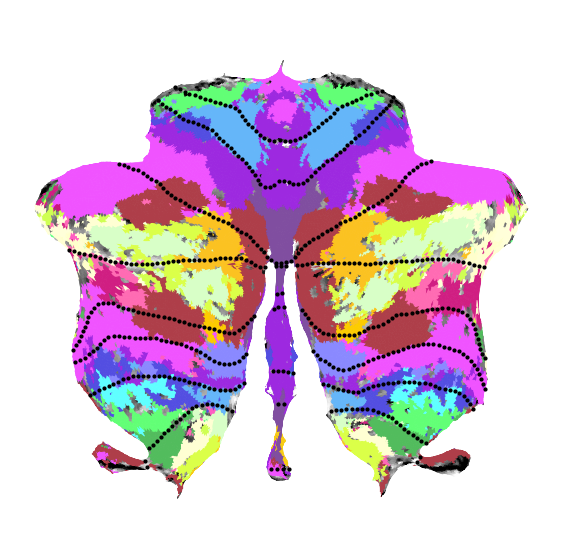

In [8]:
pseg = model_Sym68.arrange.marginal_prob().numpy()
parcel = np.argmax(pseg, axis=0) + 1
Nifti = suit_atlas.data_to_nifti(parcel)
surf_data = suit.flatmap.vol_to_surf(Nifti, stats='mode',
                                     space='MNISymC', ignore_zeros=False)
plt.figure(figsize=figsize)
ax = suit.flatmap.plot(surf_data,
    render='matplotlib',
    cmap=cmap_68,
    new_figure=True,
    label_names=labels_68,
    overlay_type='label',
    colorbar=False,
    bordersize=4)


/Users/callithrix/code/Python/Functional_Fusion/atlas_map.py:235: FutureWarning:

Image data has type int64, which may cause incompatibilities with other tools. This will error in NiBabel 5.0. This warning can be silenced by passing the dtype argument to Nifti1Image().



<Figure size 800x800 with 0 Axes>

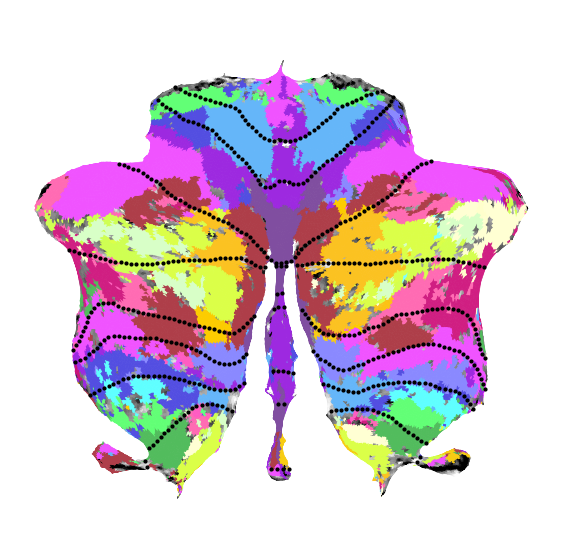

In [14]:
pseg = model_Asym68.arrange.marginal_prob().numpy()
parcel = np.argmax(pseg, axis=0) + 1
Nifti = suit_atlas.data_to_nifti(parcel)
surf_data = suit.flatmap.vol_to_surf(Nifti, stats='mode',
                                     space='MNISymC', ignore_zeros=False)
plt.figure(figsize=figsize)
ax = suit.flatmap.plot(surf_data,
                       render='matplotlib',
                       cmap=cmap_68,
                       new_figure=True,
                       label_names=labels_68,
                       overlay_type='label',
                       colorbar=False,
                       bordersize=4)

# Clustered parcellation (32)
At K=32, medium level, clustered using assignment

/Users/callithrix/code/Python/Functional_Fusion/atlas_map.py:235: FutureWarning:

Image data has type int64, which may cause incompatibilities with other tools. This will error in NiBabel 5.0. This warning can be silenced by passing the dtype argument to Nifti1Image().



<Figure size 800x800 with 0 Axes>

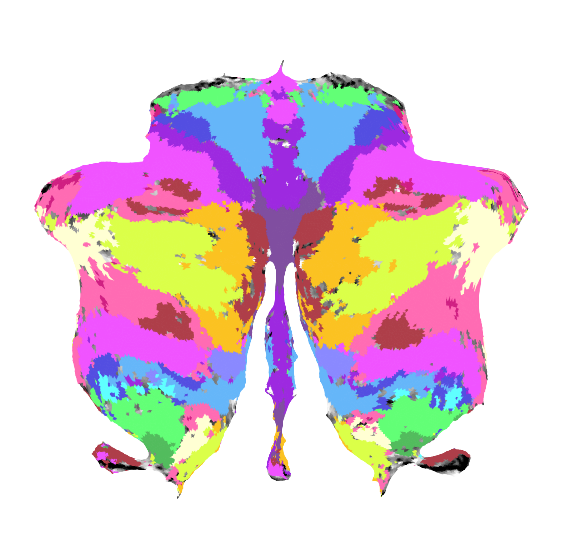

In [22]:
pseg = model_Sym32.arrange.marginal_prob().numpy()
parcel = np.argmax(pseg, axis=0) + 1
Nifti = suit_atlas.data_to_nifti(parcel)
surf_data = suit.flatmap.vol_to_surf(Nifti, stats='mode',
                                     space='MNISymC', ignore_zeros=False)
plt.figure(figsize=figsize)
ax = suit.flatmap.plot(surf_data,
                       render='matplotlib',
                       cmap=cmap_32,
                       new_figure=True,
                       label_names=labels_32,
                       overlay_type='label',
                       colorbar=False,
                       bordersize=0)


# Interavtive plots (for fine parcel labelling)

In [17]:
pseg = model_Sym68.arrange.marginal_prob().numpy()
parcel = np.argmax(pseg, axis=0) + 1
Nifti = suit_atlas.data_to_nifti(parcel)
surf_data = suit.flatmap.vol_to_surf(Nifti, stats='mode',
                                     space='MNISymC', ignore_zeros=False)
plt.figure(figsize=figsize)
ax = suit.flatmap.plot(surf_data,
                       render='plotly',
                       cmap=cmap_68,
                       new_figure=True,
                       label_names=labels_68,
                       overlay_type='label',
                       colorbar=False,
                       bordersize=0)
ax.show()
# Resize plotly figure
ax.update_layout(
    width=800,
    height=800,
)


/Users/callithrix/code/Python/Functional_Fusion/atlas_map.py:235: FutureWarning:

Image data has type int64, which may cause incompatibilities with other tools. This will error in NiBabel 5.0. This warning can be silenced by passing the dtype argument to Nifti1Image().



<Figure size 800x800 with 0 Axes>

In [20]:
pseg = model_Sym32.arrange.marginal_prob().numpy()
parcel = np.argmax(pseg, axis=0) + 1
Nifti = suit_atlas.data_to_nifti(parcel)
surf_data = suit.flatmap.vol_to_surf(Nifti, stats='mode',
                                     space='MNISymC', ignore_zeros=False)
plt.figure(figsize=figsize)
ax = suit.flatmap.plot(surf_data,
                       render='plotly',
                       cmap=cmap_32,
                       new_figure=True,
                       label_names=labels_32,
                       overlay_type='label',
                       colorbar=False,
                       bordersize=0)
ax.show()
# Resize plotly figure
ax.update_layout(
    width=800,
    height=800,
)


/Users/callithrix/code/Python/Functional_Fusion/atlas_map.py:235: FutureWarning:

Image data has type int64, which may cause incompatibilities with other tools. This will error in NiBabel 5.0. This warning can be silenced by passing the dtype argument to Nifti1Image().



<Figure size 800x800 with 0 Axes>